<a href="https://colab.research.google.com/github/LineIntegralx/CalligraNet/blob/main/EDA%20%26%20Preprocessing/Data_Preprocesing_%26_Augemntation_Tests.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Arabic Calligraphy – Preprocessing & Augmentation Playground

In this notebook, we explore **how different preprocessing, squaring, and data augmentation strategies affect Arabic calligraphy images** before we commit to any choice for model training.

We will work with a small set of **4 representative calligraphy images** and systematically apply **one transformation at a time** (unless two are naturally coupled, e.g., resize + pad). The goal is to visually and intuitively understand:

- Which operations **preserve legibility and artistic structure** of the script  
- Which operations are **too aggressive** and distort ligatures or diacritics  
- Which combinations seem most promising for **real training pipelines** (CRNN, Swin, ViT, LM-based models, etc.)

Concretely, we will test:

1. **Basic preprocessing**
   - Grayscale conversion, normalization
   - Histogram equalization, CLAHE
   - Thresholding / binarization, smoothing (Gaussian / median)

2. **Squaring / resizing strategies**
   - Direct resize (distorting aspect ratio)
   - Aspect-ratio–preserving resize + padding (letterboxing)
   - Center-crop to square
   - Simple patch/tiling views (for Swin/ViT-style encoders)

3. **Geometric augmentations**
   - Controlled rotations, translations, scaling, shear
   - Perspective transforms

4. **Photometric augmentations**
   - Brightness, contrast, saturation, hue (color jitter)
   - Blur (Gaussian / motion), noise (Gaussian, speckle, salt-and-pepper)

5. **Morphological & structural transforms**
   - Erosion, dilation (stroke thinning/thickening)
   - Light elastic deformations

6. **Background & texture augmentation**
   - Paper-like backgrounds, textures, shadows

7. **Resolution experiments**
   - Resizing to different resolutions (e.g., 128, 224, 256, 384, 512, 1024)

For each transformation, we will:

- Apply it **individually** to all 4 images (or in minimal meaningful pairs)
- Visualize the original vs transformed images side by side
- Take notes on whether the transformation is:
  - ✅ Suitable for training  
  - ⚠️ Maybe ok in moderation  
  - ❌ Too destructive for calligraphic details

By the end of this notebook, we will have a **clear, empirically grounded choice** for:

- Our **standard preprocessing pipeline**
- Our definitions of **weak / moderate / strong** augmentation for training
- The **squaring strategy** we will adopt for Swin/ViT-based models

Let’s start by loading the images and setting up some utility functions.


In [1]:
!pip install -q albumentations==1.4.6 opencv-python


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.5/153.5 kB 6.6 MB/s eta 0:00:00


In [2]:
import os
from pathlib import Path

import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

import albumentations as A

# ------------------
# CONFIG
# ------------------
# Folder where you uploaded the 4 images (in Colab, often '/content')
IMAGE_DIR = Path("/content")

# Put the *exact* filenames here (change these to your real ones)
IMAGE_NAMES = [
    "001_segment_no_0.jpg",
    "001_segment_no_0.png",
    "001-2-Al-Baqara-186-Thuluth-1_segment_no_0.jpg",
    "0011_segment_no_0.jpg",
]

# Target sizes for squaring / resolution tests
TARGET_SIZES = [128, 224, 256, 384, 512, 1024]

# ------------------
# LOAD IMAGES
# ------------------
def load_image(path: Path) -> np.ndarray:
    """Load image as RGB numpy array."""
    img = Image.open(path).convert("RGB")
    return np.array(img)

images = []
image_paths = []

for name in IMAGE_NAMES:
    p = IMAGE_DIR / name
    if not p.exists():
        print(f"WARNING: {p} does not exist, please check the filename.")
    else:
        images.append(load_image(p))
        image_paths.append(p)

print(f"Loaded {len(images)} images.")


Loaded 4 images.


In [3]:
def show_grid(img_list, titles=None, ncols=4, figsize=(16, 6)):
    """
    Show a list of images in a grid.
    """
    n = len(img_list)
    ncols = min(ncols, n)
    nrows = int(np.ceil(n / ncols))

    plt.figure(figsize=figsize)
    for i, img in enumerate(img_list):
        plt.subplot(nrows, ncols, i + 1)
        plt.imshow(img)
        plt.axis("off")
        if titles is not None:
            plt.title(titles[i], fontsize=10)
    plt.tight_layout()
    plt.show()


def apply_albu_to_image(img_rgb: np.ndarray, transform: A.BasicTransform) -> np.ndarray:
    """
    Apply an Albumentations transform to an RGB image and return RGB.
    """
    # Albumentations expects BGR by default (cv2 convention)
    img_bgr = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR)
    augmented = transform(image=img_bgr)["image"]
    # Back to RGB for plotting
    img_rgb_out = cv2.cvtColor(augmented, cv2.COLOR_BGR2RGB)
    return img_rgb_out


def apply_and_show(transform, name: str, imgs=images):
    """
    Apply a single transform to all loaded images and show
    original vs transformed side by side.
    """
    out = []
    titles = []
    for idx, img in enumerate(imgs):
        out.append(img)
        titles.append(f"Orig {idx+1}")
        out.append(apply_albu_to_image(img, transform))
        titles.append(f"{name} {idx+1}")
    print(f"=== Transform: {name} ===")
    show_grid(out, titles, ncols=4, figsize=(16, 8))


In [7]:
# 1) BASIC PREPROCESSING TRANSFORMS

preproc_transforms = {
    "grayscale": A.Compose([
        A.ToGray(always_apply=True),
    ]),
    "hist_eq": A.Compose([
        A.ToGray(always_apply=True),
        A.CLAHE(clip_limit=4.0, tile_grid_size=(8, 8), always_apply=True),
    ]),
    "clahe_color": A.Compose([
        A.CLAHE(clip_limit=4.0, tile_grid_size=(8, 8), always_apply=True),
    ]),
    "gaussian_blur_light": A.Compose([
        A.GaussianBlur(blur_limit=3, always_apply=True),
    ]),
    "gaussian_blur_strong": A.Compose([
        A.GaussianBlur(blur_limit=7, always_apply=True),
    ]),
    "median_blur": A.Compose([
        A.MedianBlur(blur_limit=5, always_apply=True),
    ]),
    "otsu_threshold": A.Compose([
        A.ToGray(always_apply=True),
        A.ImageCompression(quality_lower=90, quality_upper=100, p=0.0),  # no-op
        # We'll do threshold manually in a lambda
    ]),
}

# small helper for Otsu threshold since Albumentations has no direct op
def otsu_transform(image, **kwargs):
    # image is BGR here
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, th = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    th_bgr = cv2.cvtColor(th, cv2.COLOR_GRAY2BGR)
    return th_bgr  # <-- return ndarray, not dict

preproc_transforms["otsu_threshold"] = A.Lambda(image=otsu_transform)


=== Transform: grayscale ===


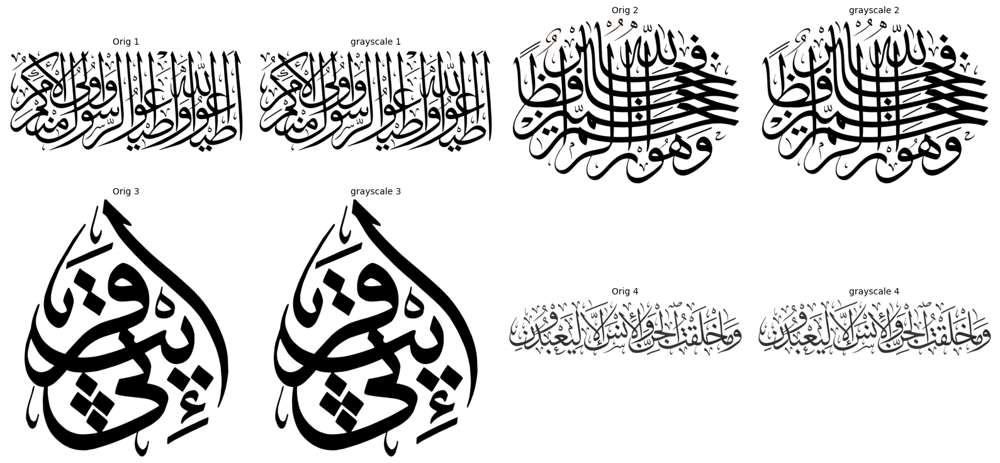

=== Transform: hist_eq ===


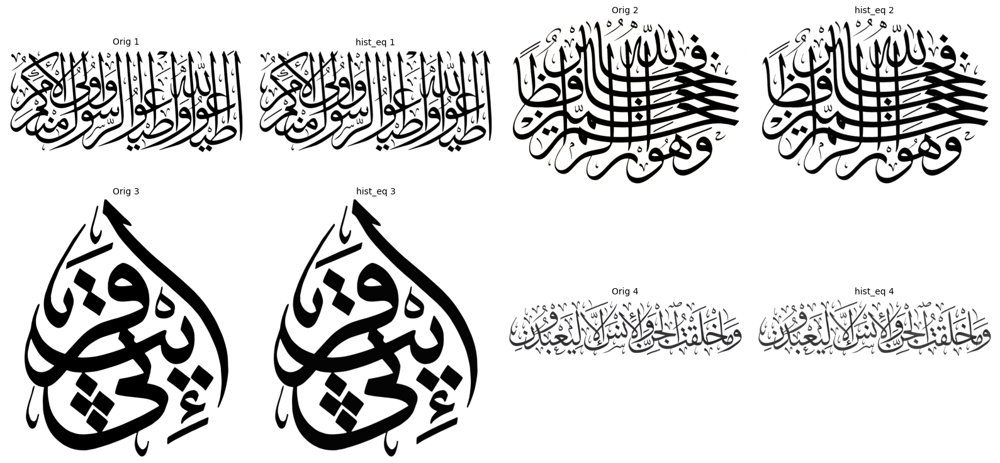

In [5]:
apply_and_show(preproc_transforms["grayscale"], "grayscale")
# or:
apply_and_show(preproc_transforms["hist_eq"], "hist_eq")


=== Transform: clahe_color ===


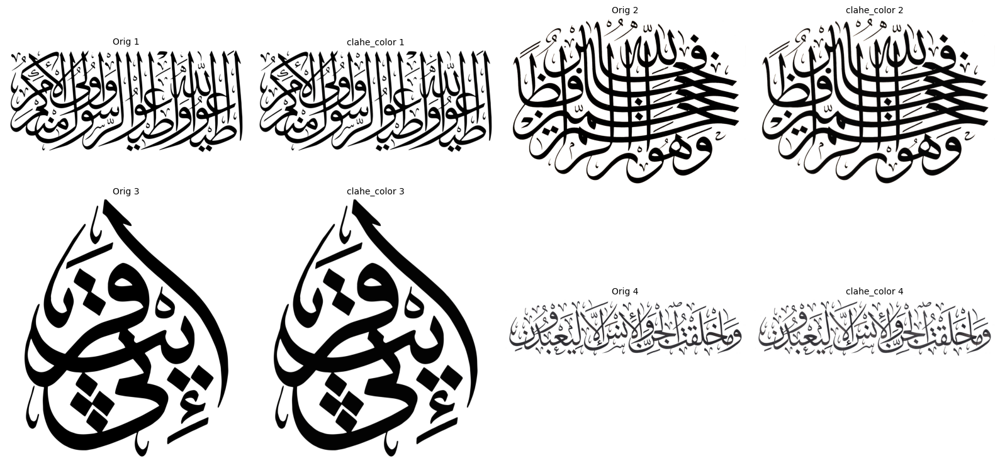

=== Transform: gaussian_blur_light ===


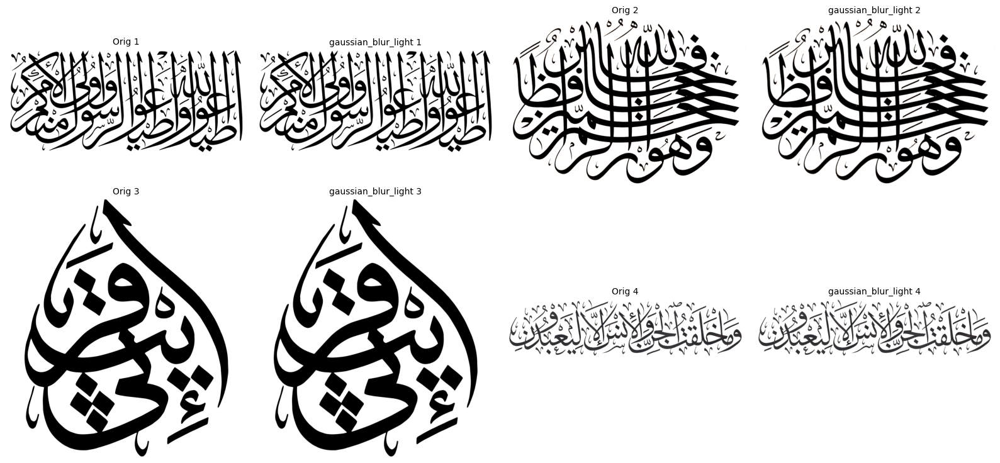

=== Transform: gaussian_blur_strong ===


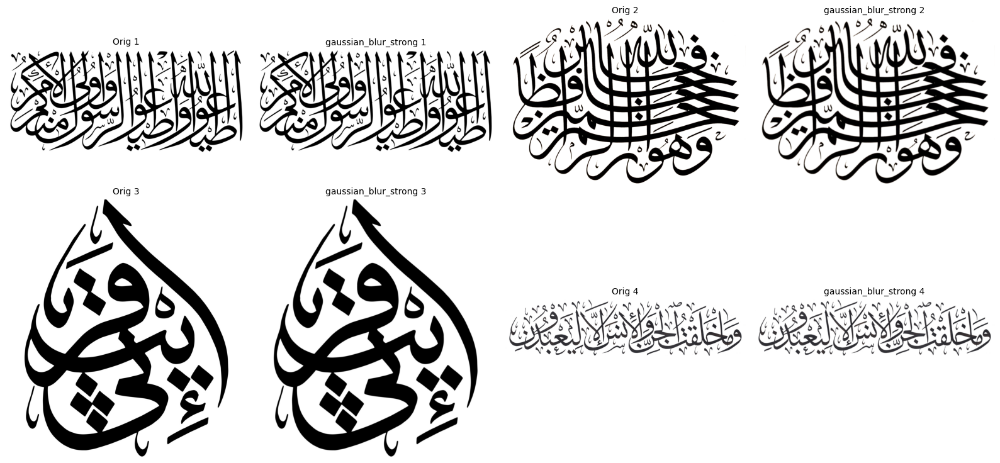

=== Transform: median_blur ===


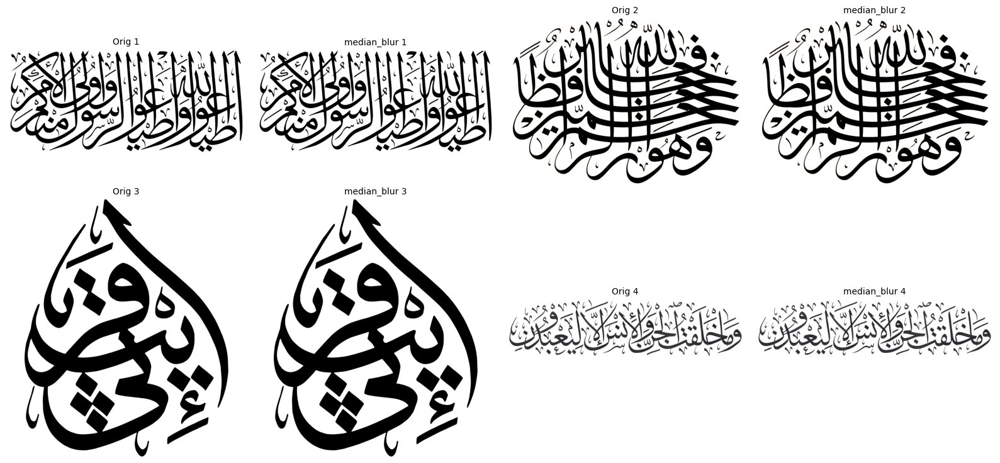

error: OpenCV(4.12.0) :-1: error: (-5:Bad argument) in function 'cvtColor'
> Overload resolution failed:
>  - src is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'src'


In [6]:
# 3) CLAHE on color image
apply_and_show(preproc_transforms["clahe_color"], "clahe_color")
# 4) Gaussian blur (light)
apply_and_show(preproc_transforms["gaussian_blur_light"], "gaussian_blur_light")
# 5) Gaussian blur (strong)
apply_and_show(preproc_transforms["gaussian_blur_strong"], "gaussian_blur_strong")
# 6) Median blur
apply_and_show(preproc_transforms["median_blur"], "median_blur")



=== Transform: otsu_threshold ===


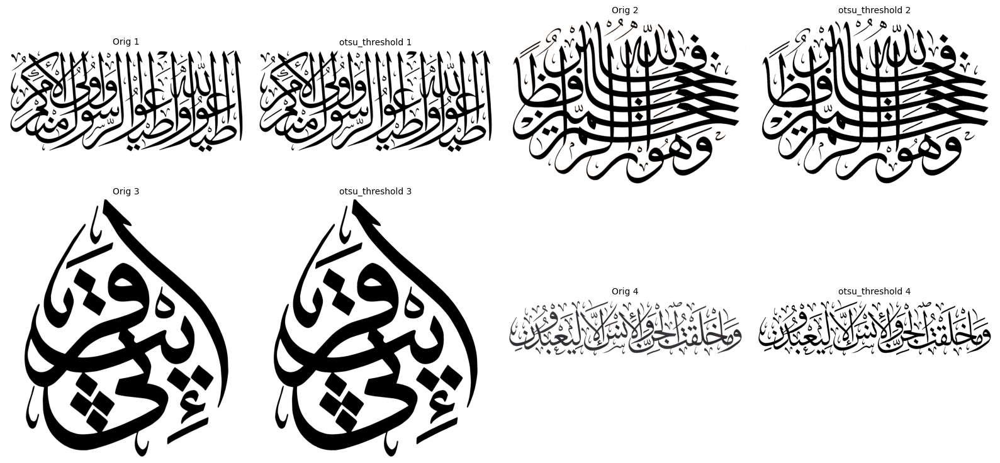

In [8]:
# 7) Otsu thresholding
apply_and_show(preproc_transforms["otsu_threshold"], "otsu_threshold")

=== Transform: direct_resize ===


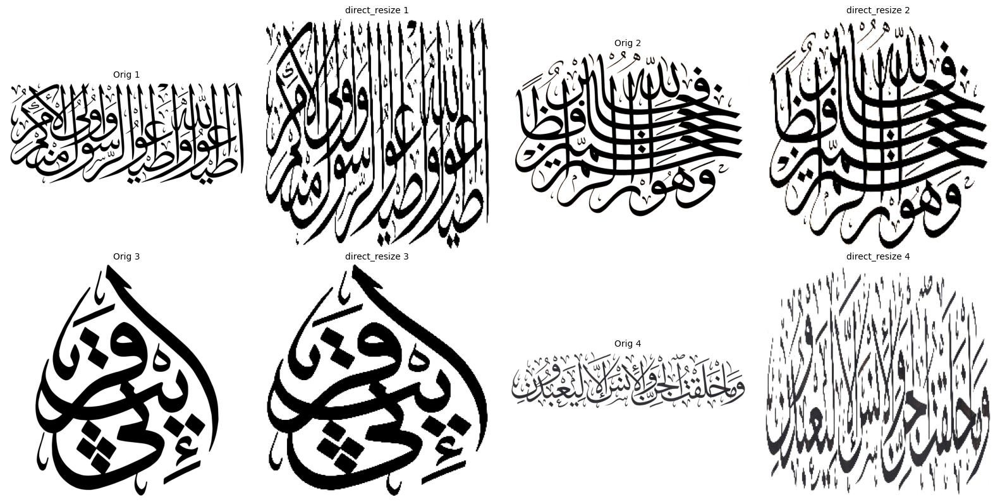

=== Transform: letterbox ===


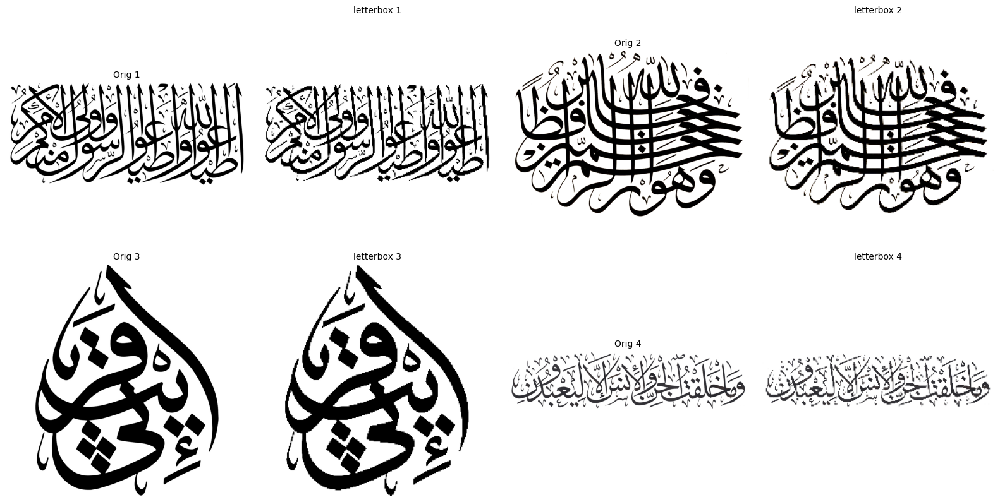

=== Transform: center_crop_square ===


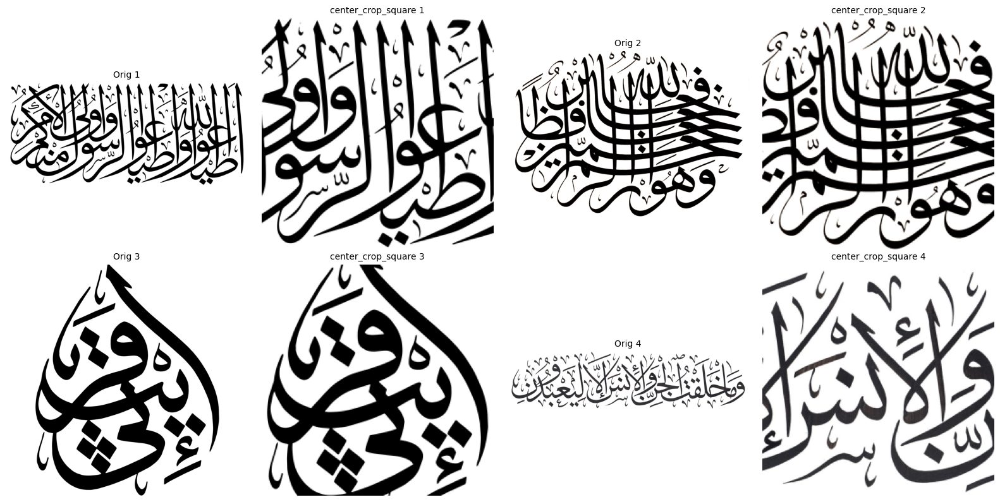

In [10]:
# 2) SQUARING / RESIZING STRATEGIES

SQUARE_SIZE = 256  # you can change to 224 or 384 etc.


def make_direct_resize_transform(size=SQUARE_SIZE):
    # Distorts aspect ratio
    return A.Compose([
        A.Resize(size, size, always_apply=True),
    ])


def make_letterbox_transform(size=SQUARE_SIZE):
    # Preserve aspect ratio, pad to square
    return A.Compose([
        A.LongestMaxSize(max_size=size, always_apply=True),
        A.PadIfNeeded(min_height=size, min_width=size,
                      border_mode=cv2.BORDER_CONSTANT,
                      value=(255, 255, 255),
                      position='center', always_apply=True),
    ])


def make_center_crop_square_transform(size=SQUARE_SIZE):
    # Center-crop largest square, then resize to size
    def _center_crop(image, **kwargs):
        h, w = image.shape[:2]
        side = min(h, w)
        y0 = (h - side) // 2
        x0 = (w - side) // 2
        cropped = image[y0:y0+side, x0:x0+side]
        resized = cv2.resize(cropped, (size, size), interpolation=cv2.INTER_AREA)
        return resized   # <-- return ndarray, NOT {"image": ...}
    return A.Lambda(image=_center_crop)



square_transforms = {
    "direct_resize": make_direct_resize_transform(),
    "letterbox": make_letterbox_transform(),
    "center_crop_square": make_center_crop_square_transform(),
}

# Example: test squaring
apply_and_show(square_transforms["direct_resize"], "direct_resize")
apply_and_show(square_transforms["letterbox"], "letterbox")
apply_and_show(square_transforms["center_crop_square"], "center_crop_square")


=== Transform: rotate_5deg ===


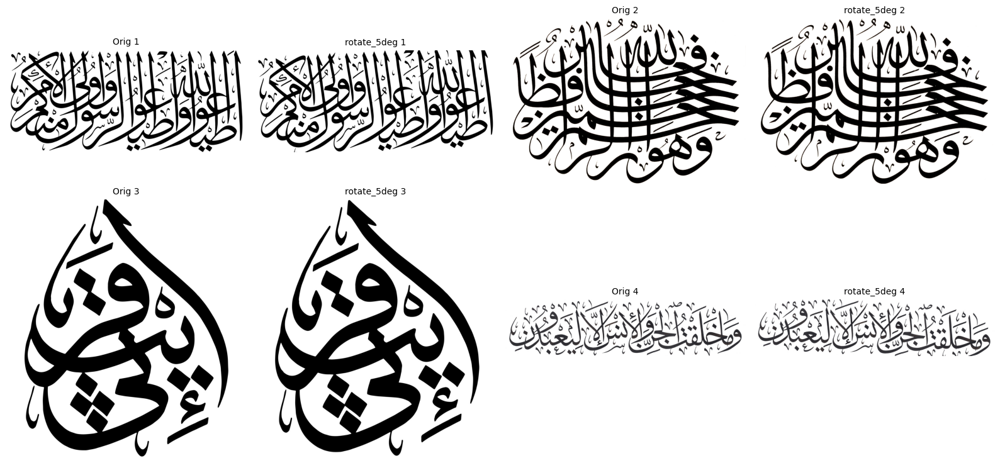

In [11]:
# 3) GEOMETRIC AUGMENTATIONS

geom_transforms = {
    "rotate_2deg": A.Compose([A.Rotate(limit=2, border_mode=cv2.BORDER_CONSTANT, value=(255,255,255), always_apply=True)]),
    "rotate_5deg": A.Compose([A.Rotate(limit=5, border_mode=cv2.BORDER_CONSTANT, value=(255,255,255), always_apply=True)]),
    "rotate_15deg": A.Compose([A.Rotate(limit=15, border_mode=cv2.BORDER_CONSTANT, value=(255,255,255), always_apply=True)]),
    "translate_small": A.Compose([A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.0, rotate_limit=0,
                                                     border_mode=cv2.BORDER_CONSTANT, value=(255,255,255), always_apply=True)]),
    "scale_90_110": A.Compose([A.ShiftScaleRotate(shift_limit=0.0, scale_limit=0.1, rotate_limit=0,
                                                  border_mode=cv2.BORDER_CONSTANT, value=(255,255,255), always_apply=True)]),
    "shear_small": A.Compose([A.Affine(shear=(-5, 5), fit_output=True,
                                       mode=cv2.BORDER_CONSTANT, cval=(255,255,255), always_apply=True)]),
    "perspective_light": A.Compose([A.Perspective(scale=(0.02, 0.05), keep_size=True,
                                                  pad_mode=cv2.BORDER_CONSTANT, pad_val=(255,255,255), always_apply=True)]),
    "perspective_strong": A.Compose([A.Perspective(scale=(0.05, 0.1), keep_size=True,
                                                   pad_mode=cv2.BORDER_CONSTANT, pad_val=(255,255,255), always_apply=True)]),
}

# Example:
apply_and_show(geom_transforms["rotate_5deg"], "rotate_5deg")


=== Transform: rotate_2deg ===


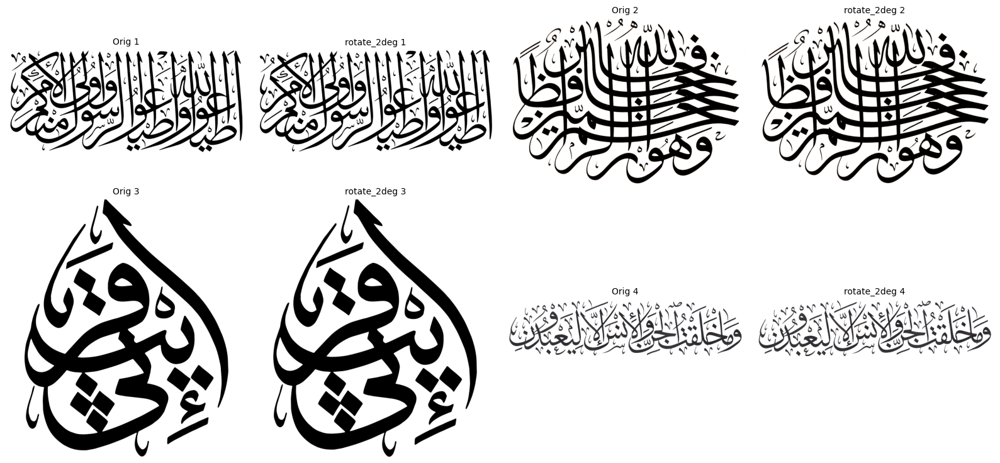

=== Transform: rotate_5deg ===


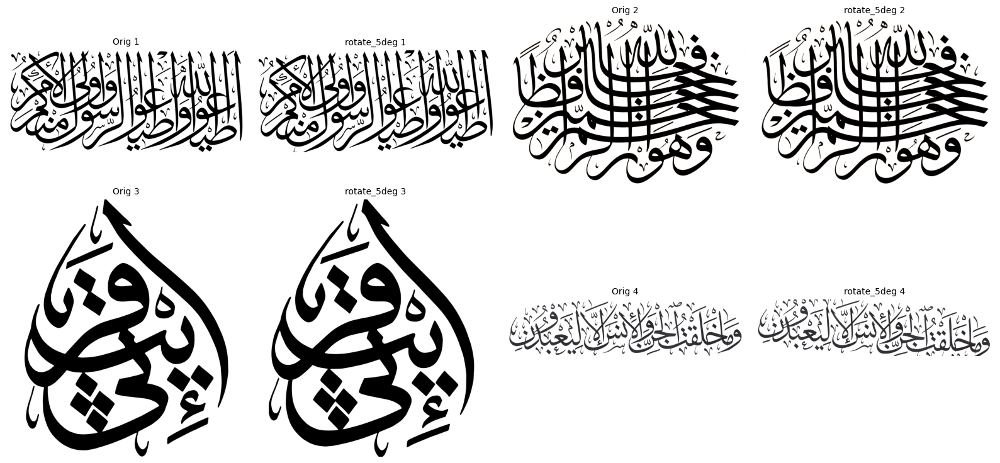

=== Transform: rotate_15deg ===


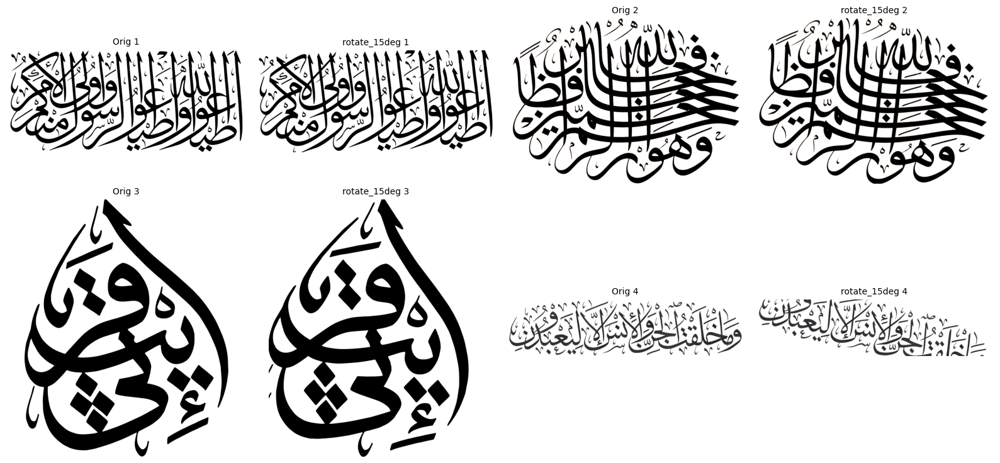

=== Transform: translate_small ===


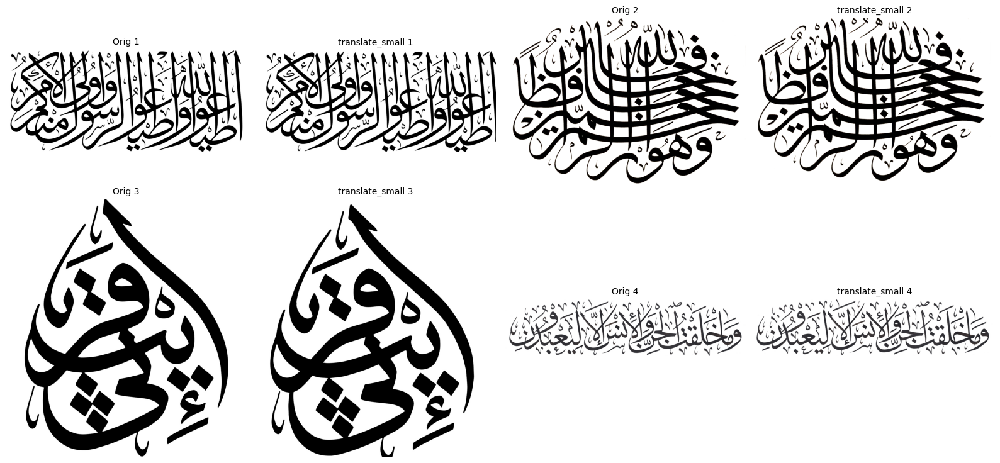

=== Transform: scale_90_110 ===


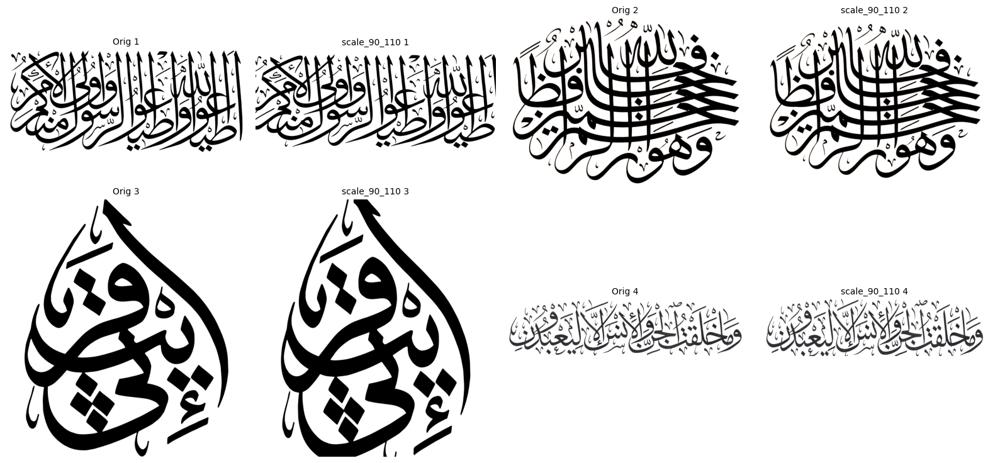

=== Transform: shear_small ===


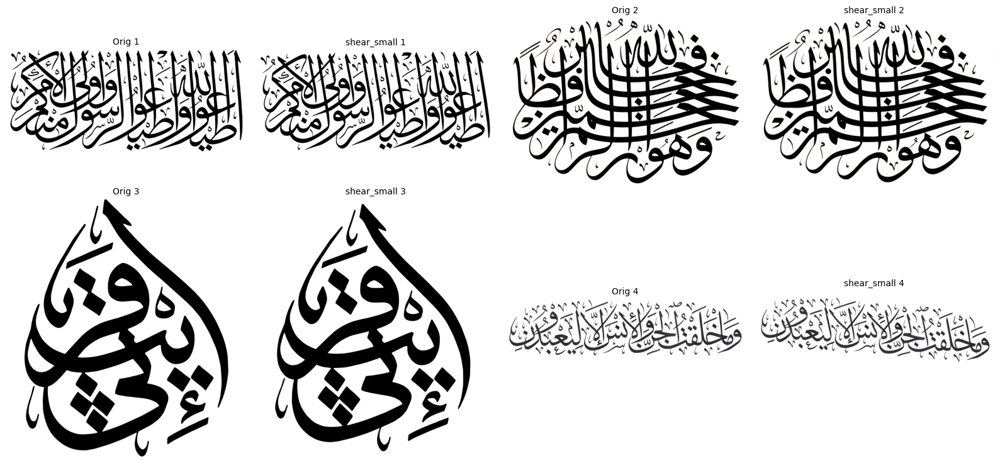

=== Transform: perspective_light ===


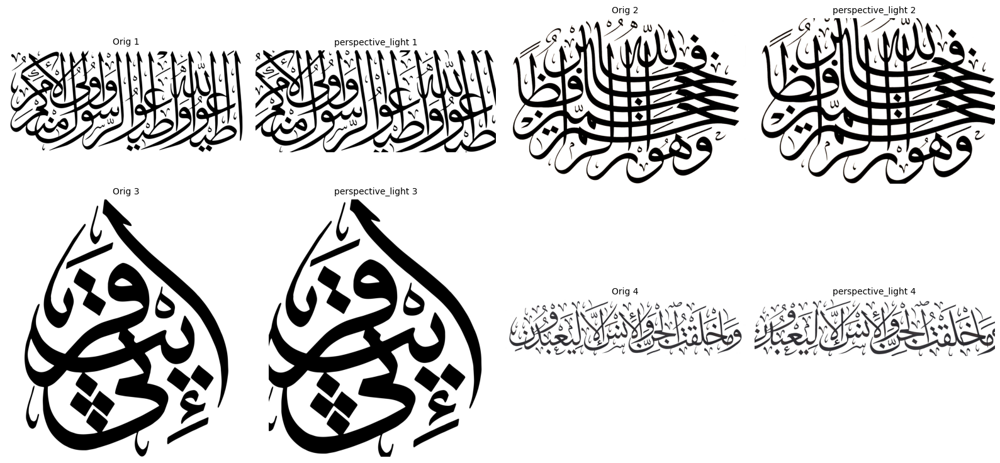

=== Transform: perspective_strong ===


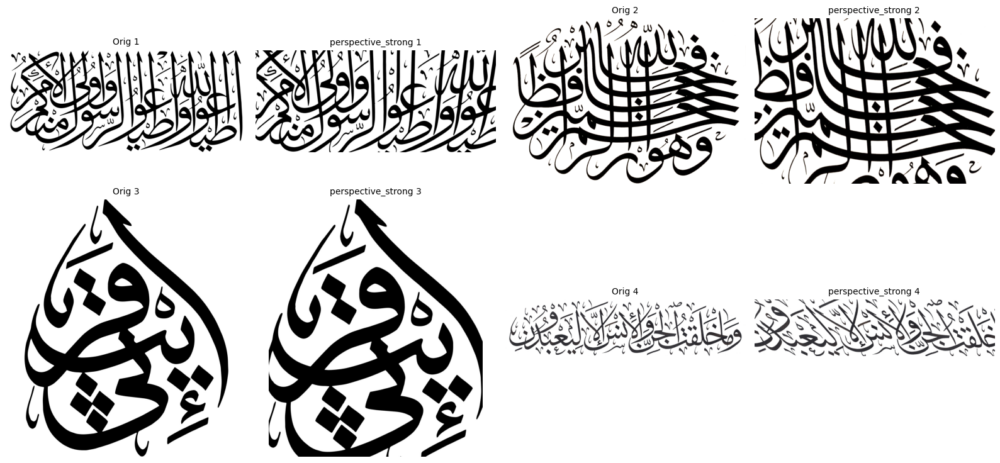

In [12]:
apply_and_show(geom_transforms["rotate_2deg"], "rotate_2deg")
apply_and_show(geom_transforms["rotate_5deg"], "rotate_5deg")
apply_and_show(geom_transforms["rotate_15deg"], "rotate_15deg")

apply_and_show(geom_transforms["translate_small"], "translate_small")
apply_and_show(geom_transforms["scale_90_110"], "scale_90_110")

apply_and_show(geom_transforms["shear_small"], "shear_small")

apply_and_show(geom_transforms["perspective_light"], "perspective_light")
apply_and_show(geom_transforms["perspective_strong"], "perspective_strong")


/usr/local/lib/python3.12/dist-packages/pydantic/main.py:464: UserWarning: Pydantic serializer warnings:
  PydanticSerializationUnexpectedValue(Expected `float` - serialized value may not be as expected [field_name='brightness', input_value=[0.9, 1.1], input_type=list])
  PydanticSerializationUnexpectedValue(Expected `tuple[float, float]` - serialized value may not be as expected [field_name='brightness', input_value=[0.9, 1.1], input_type=list])
  PydanticSerializationUnexpectedValue(Expected `float` - serialized value may not be as expected [field_name='contrast', input_value=[0.9, 1.1], input_type=list])
  PydanticSerializationUnexpectedValue(Expected `tuple[float, float]` - serialized value may not be as expected [field_name='contrast', input_value=[0.9, 1.1], input_type=list])
  PydanticSerializationUnexpectedValue(Expected `float` - serialized value may not be as expected [field_name='saturation', input_value=[0.9, 1.1], input_type=list])
  PydanticSerializationUnexpectedValue(Ex

=== Transform: color_jitter_low ===


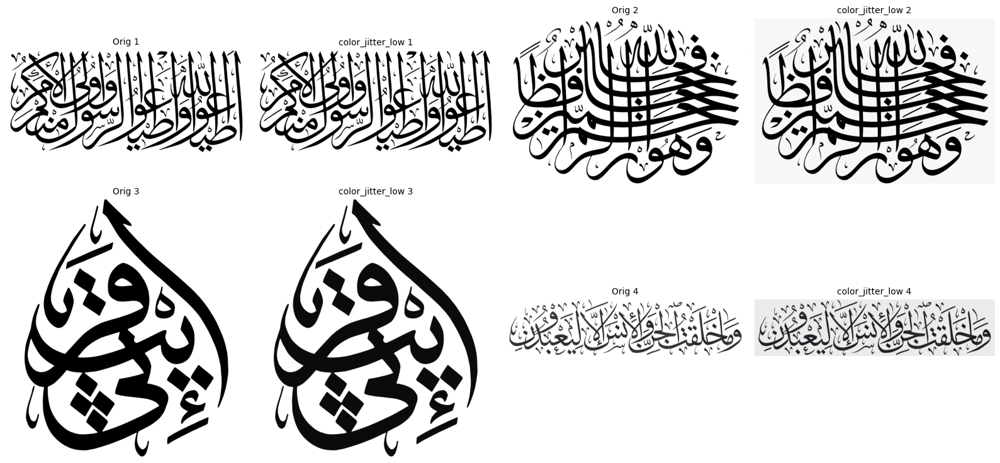

=== Transform: color_jitter_high ===


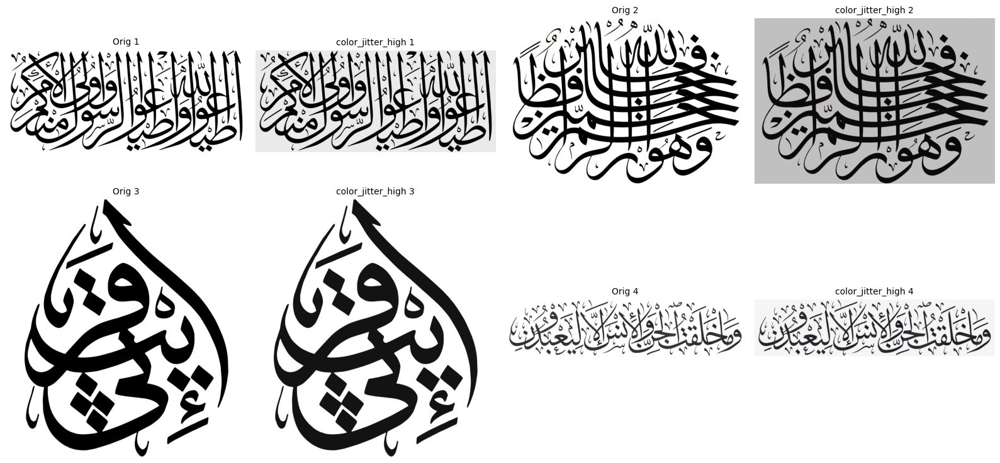

=== Transform: brightness_contrast_low ===


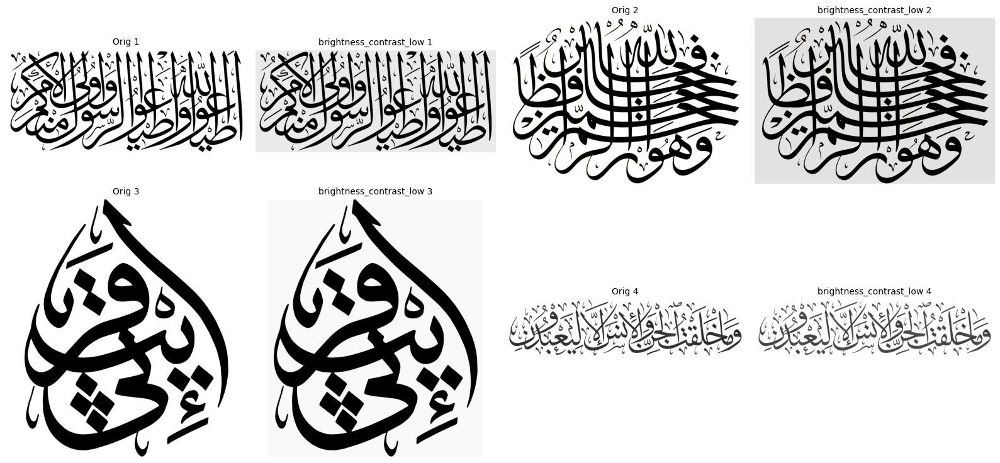

=== Transform: brightness_contrast_high ===


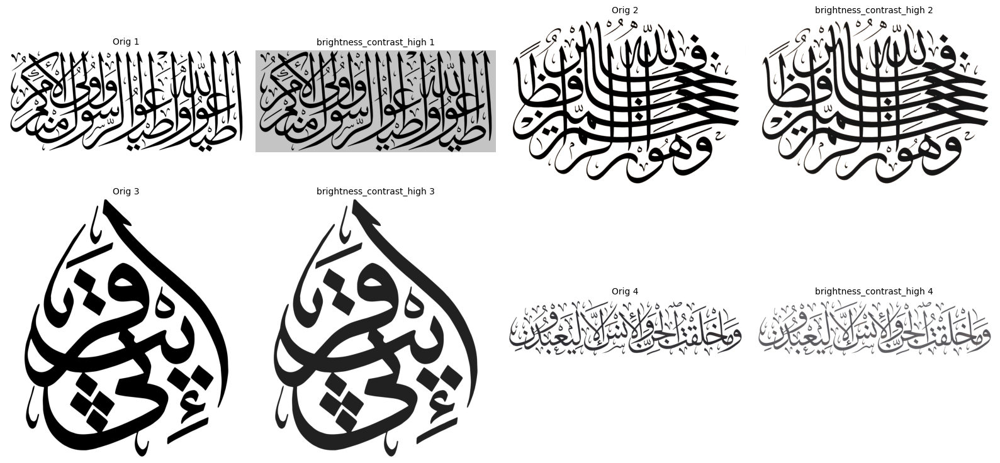

=== Transform: gauss_noise_light ===


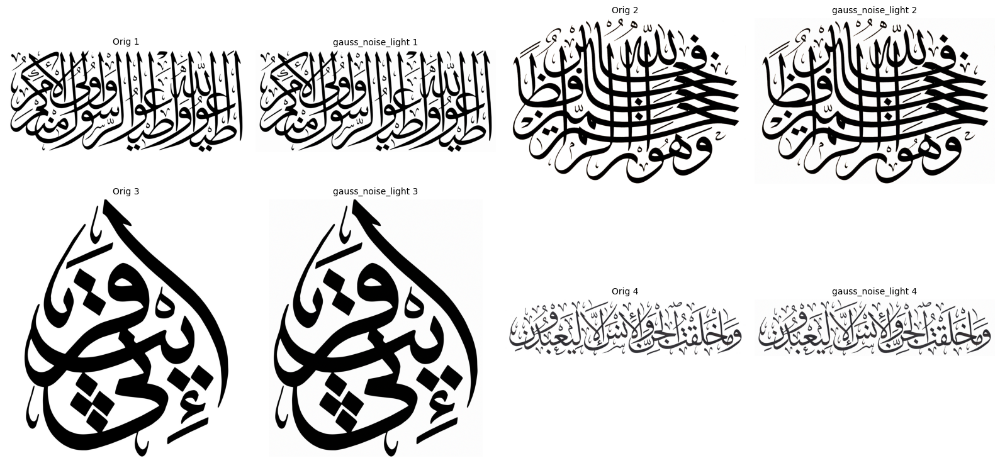

=== Transform: gauss_noise_strong ===


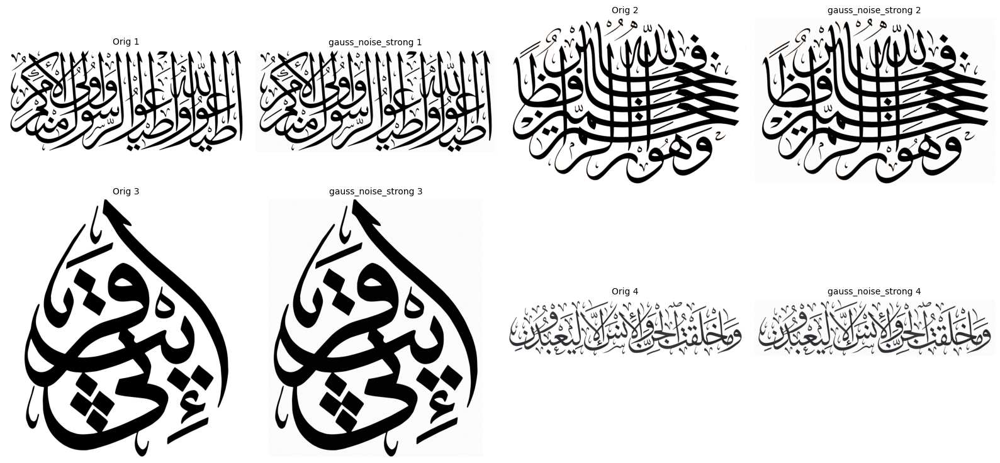

=== Transform: motion_blur ===


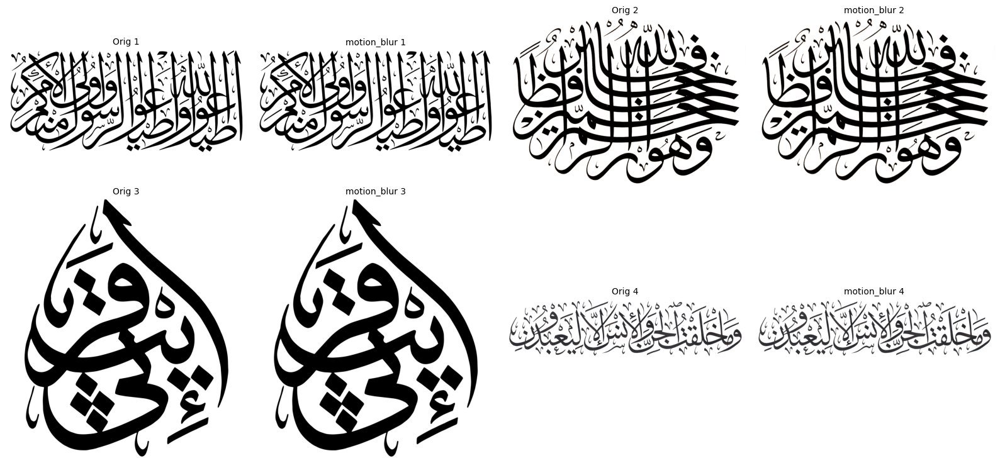

In [13]:
# 4) PHOTOMETRIC AUGMENTATIONS

photo_transforms = {
    "color_jitter_low": A.Compose([
        A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.02, always_apply=True)
    ]),
    "color_jitter_high": A.Compose([
        A.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.05, always_apply=True)
    ]),
    "brightness_contrast_low": A.Compose([
        A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, always_apply=True)
    ]),
    "brightness_contrast_high": A.Compose([
        A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, always_apply=True)
    ]),
    "gauss_noise_light": A.Compose([
        A.GaussNoise(var_limit=(5, 20), always_apply=True)
    ]),
    "gauss_noise_strong": A.Compose([
        A.GaussNoise(var_limit=(30, 60), always_apply=True)
    ]),
    "motion_blur": A.Compose([
        A.MotionBlur(blur_limit=7, always_apply=True)
    ]),
}

# Example:
apply_and_show(photo_transforms["color_jitter_low"], "color_jitter_low")
apply_and_show(photo_transforms["color_jitter_high"], "color_jitter_high")
apply_and_show(photo_transforms["brightness_contrast_low"], "brightness_contrast_low")
apply_and_show(photo_transforms["brightness_contrast_high"], "brightness_contrast_high")
apply_and_show(photo_transforms["gauss_noise_light"], "gauss_noise_light")
apply_and_show(photo_transforms["gauss_noise_strong"], "gauss_noise_strong")
apply_and_show(photo_transforms["motion_blur"], "motion_blur")


=== Transform: erode_light ===


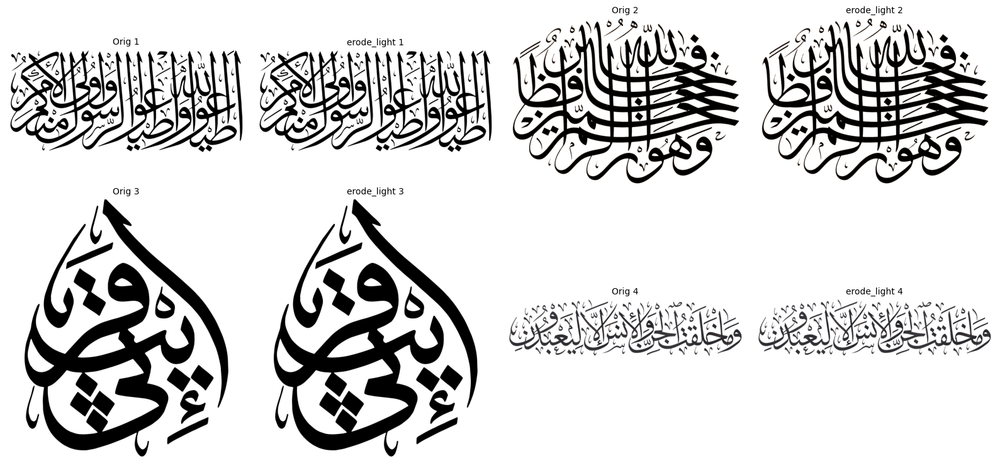

=== Transform: erode_strong ===


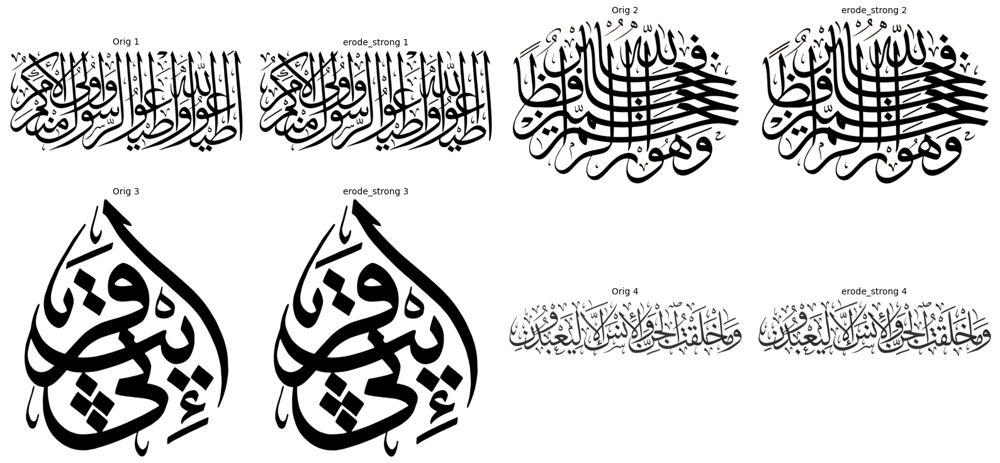

=== Transform: dilate_light ===


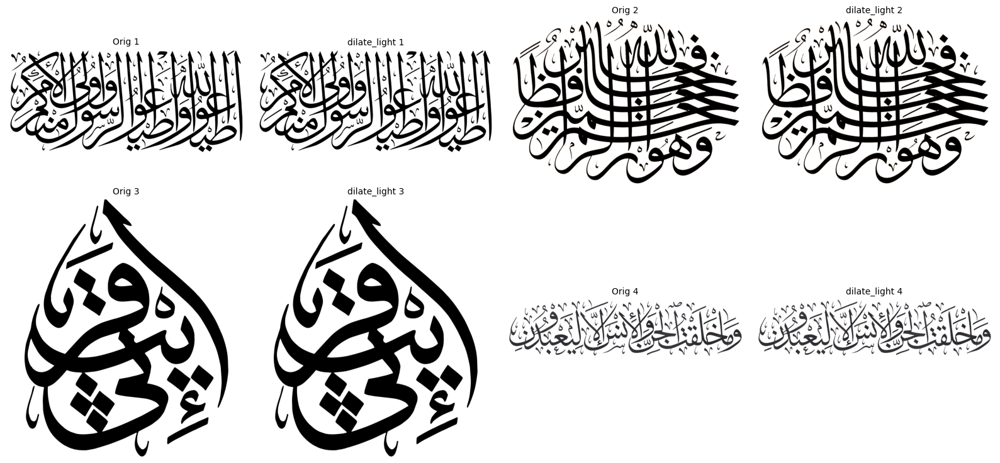

=== Transform: dilate_strong ===


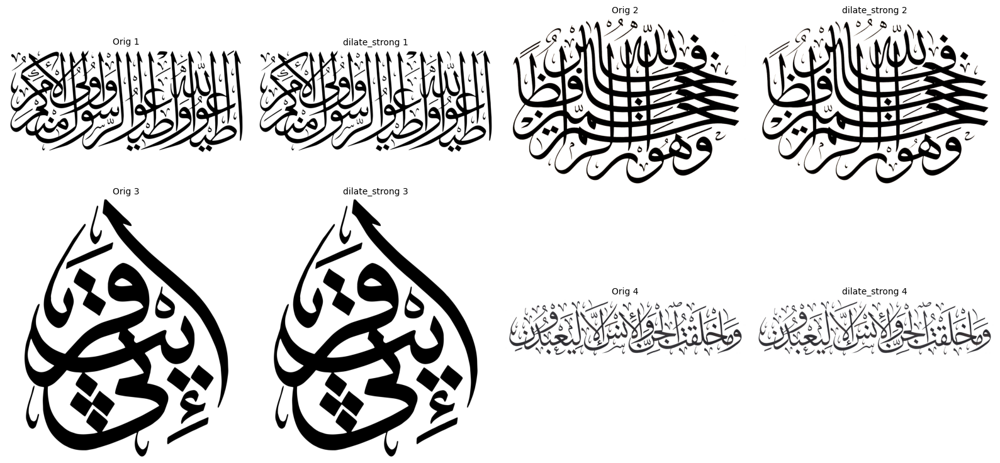

=== Transform: elastic_light ===


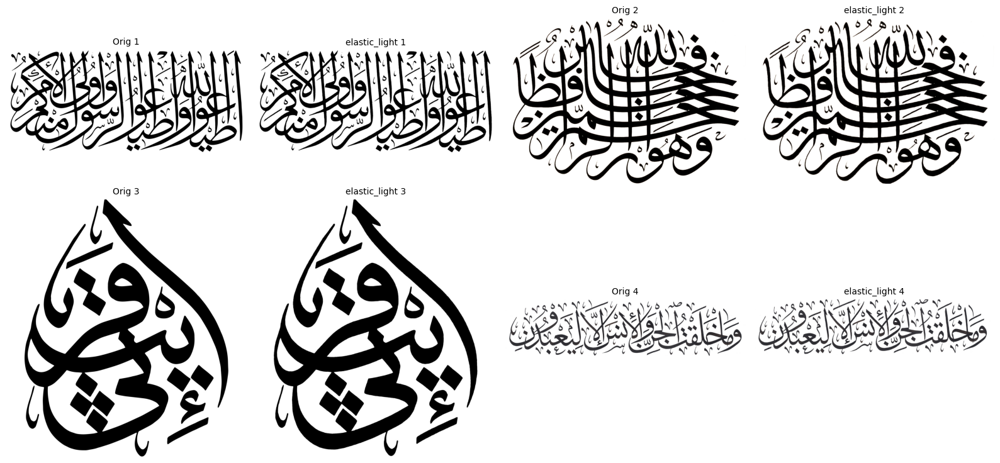

In [15]:
# 5) MORPHOLOGICAL & STRUCTURAL

def make_erode_transform(kernel_size=2):
    def _erode(image, **kwargs):
        k = np.ones((kernel_size, kernel_size), np.uint8)
        eroded = cv2.erode(image, k, iterations=1)
        return eroded          # ← return the image ONLY
    return A.Lambda(image=_erode, always_apply=True)


def make_dilate_transform(kernel_size=2):
    def _dilate(image, **kwargs):
        k = np.ones((kernel_size, kernel_size), np.uint8)
        dilated = cv2.dilate(image, k, iterations=1)
        return dilated         # ← return the image ONLY
    return A.Lambda(image=_dilate, always_apply=True)

    return A.Lambda(image=_dilate)

morph_transforms = {
    "erode_light": make_erode_transform(1),
    "erode_strong": make_erode_transform(2),
    "dilate_light": make_dilate_transform(1),
    "dilate_strong": make_dilate_transform(2),
    "elastic_light": A.Compose([
        A.ElasticTransform(alpha=10, sigma=5, alpha_affine=5,
                           border_mode=cv2.BORDER_CONSTANT, value=(255,255,255), always_apply=True)
    ]),
}

# Example:
apply_and_show(morph_transforms["erode_light"], "erode_light")
apply_and_show(morph_transforms["erode_strong"], "erode_strong")
apply_and_show(morph_transforms["dilate_light"], "dilate_light")
apply_and_show(morph_transforms["dilate_strong"], "dilate_strong")
apply_and_show(morph_transforms["elastic_light"], "elastic_light")


=== Transform: paper_noise ===


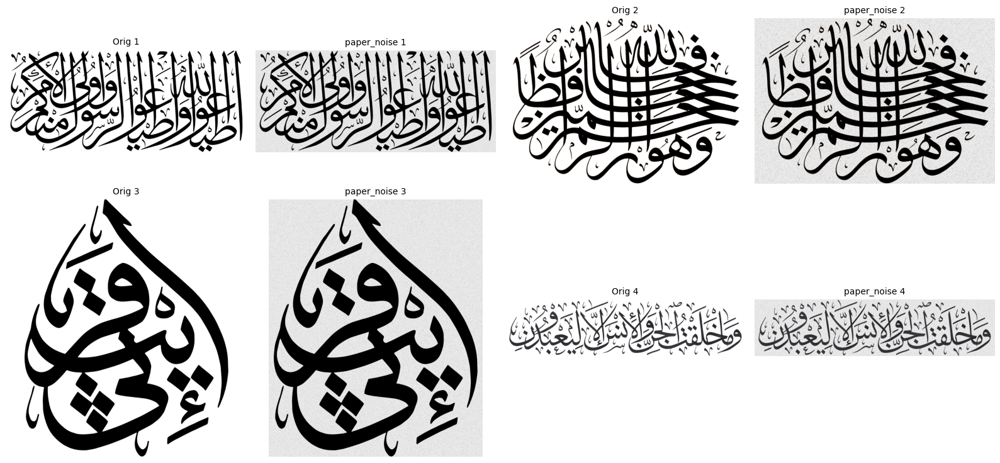

In [17]:
# 6) BACKGROUND-LIKE NOISE

def add_paper_noise(image, **kwargs):
    """Add low-frequency noise to simulate paper background."""
    h, w = image.shape[:2]

    # base noise around white
    noise = np.random.normal(loc=235, scale=10, size=(h, w, 1)).astype(np.uint8)
    noise = np.repeat(noise, 3, axis=2)

    img = image.astype(np.uint8)

    # only affect very light pixels
    mask = (img > 240).astype(np.uint8)

    # do blending in float to avoid overflow
    blended = img.astype(np.float32) * (1 - mask) + noise.astype(np.float32) * mask
    blended = blended.astype(np.uint8)

    return blended   # ✅ not {"image": blended}


background_transforms = {
    "paper_noise": A.Lambda(image=add_paper_noise),
}

# Example:
apply_and_show(background_transforms["paper_noise"], "paper_noise")


=== Resolution: 128x128 ===
=== Transform: resize_128 ===


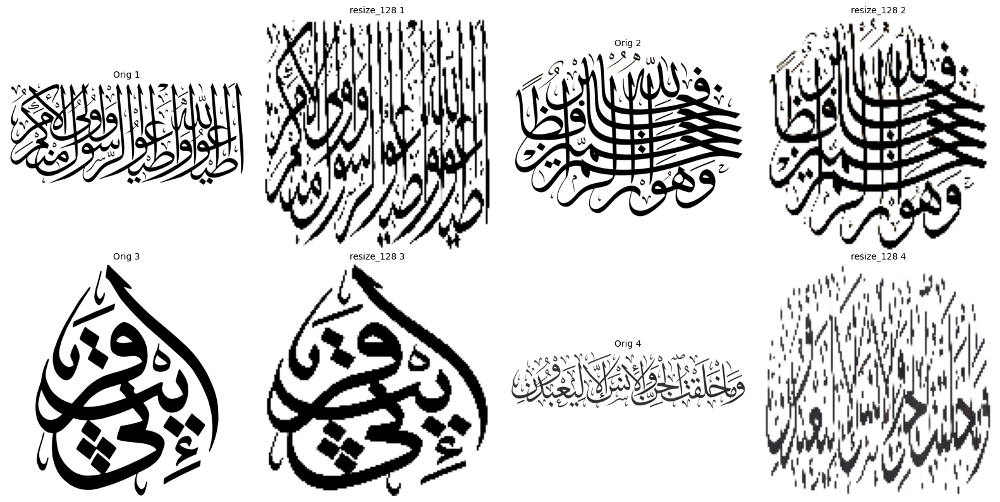

=== Resolution: 256x256 ===
=== Transform: resize_256 ===


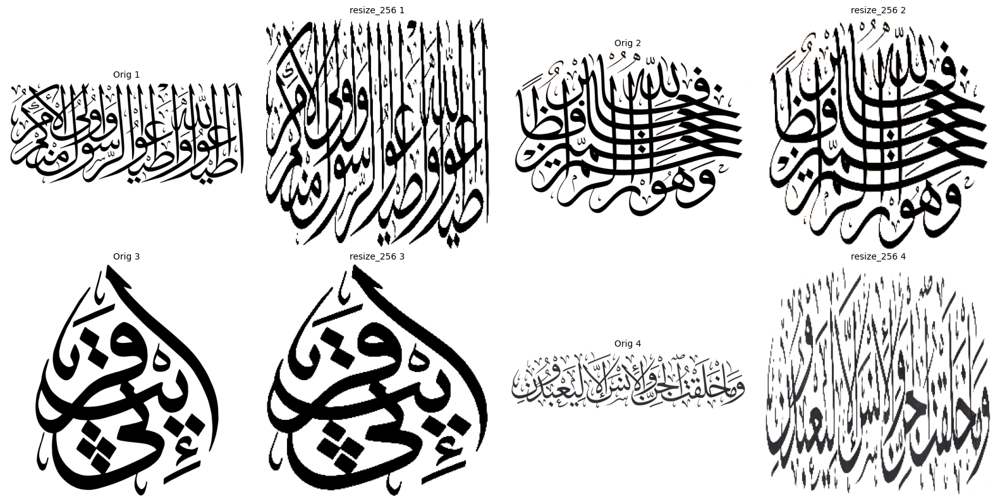

=== Resolution: 512x512 ===
=== Transform: resize_512 ===


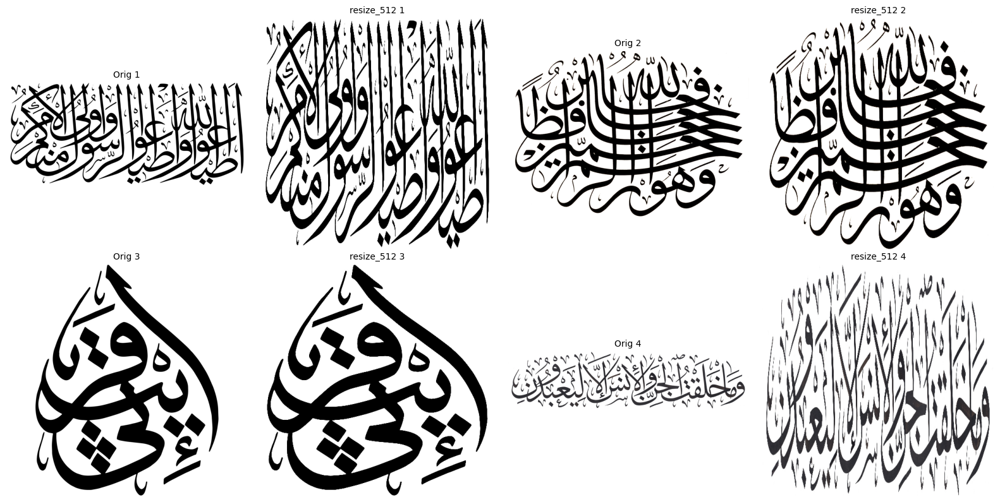

In [18]:
# 7) RESOLUTION TESTS

def make_resize_to(size):
    return A.Compose([
        A.Resize(size, size, always_apply=True)
    ])

def test_resolution(size_list=TARGET_SIZES):
    for s in size_list:
        tfm = make_resize_to(s)
        print(f"=== Resolution: {s}x{s} ===")
        apply_and_show(tfm, f"resize_{s}")

# Example: test a couple
test_resolution([128, 256, 512])
